In [1]:
import cv2
import matplotlib.pyplot as plt
#import mediapipe as mp
#import mediapipe.framework.formats.landmark_pb2 as landmark_pb2
import os
from tensorflow.keras import backend as K
from keras.utils import to_categorical
import numpy as np

from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import TensorBoard
from sklearn.metrics import multilabel_confusion_matrix, accuracy_score
from keras.callbacks import EarlyStopping
from PIL import Image


import pandas as pd
import seaborn as sns

2023-08-20 14:06:31.223312: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


### TEST

In [2]:
from tensorflow.keras.models import load_model
model = load_model('./models/model_SU_1.h5')

In [157]:
test_data_folder = 'test_play_2'

In [158]:
label_mapping = {"X": 0, "Run": 1, "Pose": 2, "Squat": 3, "Stand": 4}

In [159]:
def reshape_landmarks(X):
    num_samples, num_landmarks, num_dimensions = X.shape
    X_reshaped = X.reshape(num_samples, num_landmarks * num_dimensions)
    
    return X_reshaped

In [160]:
sorted(os.listdir(os.path.join(test_data_folder, "landmarks")))

['1692538646.npy',
 '1692538649.npy',
 '1692538652.npy',
 '1692538655.npy',
 '1692538658.npy',
 '1692538662.npy',
 '1692538665.npy',
 '1692538668.npy',
 '1692538671.npy',
 '1692538674.npy',
 '1692538677.npy',
 '1692538680.npy',
 '1692541014.npy',
 '1692541017.npy',
 '1692541020.npy',
 '1692541035.npy',
 '1692541038.npy',
 '1692541041.npy',
 '1692541045.npy',
 '1692541048.npy',
 '1692541051.npy',
 '1692541054.npy',
 '1692541057.npy',
 '1692541060.npy',
 '1692541197.npy',
 '1692541200.npy',
 '1692541203.npy',
 '1692541265.npy',
 '1692542598.npy',
 '1692542601.npy',
 '1692542604.npy',
 '1692542607.npy',
 '1692542610.npy',
 '1692542613.npy',
 '1692542617.npy',
 '1692542620.npy',
 '1692542623.npy',
 '1692542626.npy',
 '1692542629.npy',
 '1692542632.npy',
 '1692542691.npy',
 '1692542694.npy',
 '1692542697.npy',
 '1692542700.npy',
 '1692542703.npy',
 '1692542707.npy',
 '1692542710.npy',
 '1692542713.npy',
 '1692542716.npy',
 '1692542719.npy',
 '1692542722.npy',
 '1692542725.npy']

In [161]:
def load_and_preprocess_test_data(test_folder):
    X_test = []
    test_folder = os.path.join(test_data_folder, "landmarks")
    for file_name in sorted(os.listdir(test_folder)):
        if file_name.endswith('.npy'):
            data = np.load(os.path.join(test_folder, file_name))
            X_test.append(data)
            print(file_name)

    X_test = np.array(X_test)
    X_test_flattened = reshape_landmarks(X_test)
    
    return X_test_flattened


In [163]:
X_test = load_and_preprocess_test_data(test_data_folder)

1692538646.npy
1692538649.npy
1692538652.npy
1692538655.npy
1692538658.npy
1692538662.npy
1692538665.npy
1692538668.npy
1692538671.npy
1692538674.npy
1692538677.npy
1692538680.npy
1692541014.npy
1692541017.npy
1692541020.npy
1692541035.npy
1692541038.npy
1692541041.npy
1692541045.npy
1692541048.npy
1692541051.npy
1692541054.npy
1692541057.npy
1692541060.npy
1692541197.npy
1692541200.npy
1692541203.npy
1692541265.npy
1692542598.npy
1692542601.npy
1692542604.npy
1692542607.npy
1692542610.npy
1692542613.npy
1692542617.npy
1692542620.npy
1692542623.npy
1692542626.npy
1692542629.npy
1692542632.npy
1692542691.npy
1692542694.npy
1692542697.npy
1692542700.npy
1692542703.npy
1692542707.npy
1692542710.npy
1692542713.npy
1692542716.npy
1692542719.npy
1692542722.npy
1692542725.npy


In [164]:
X_test.shape

(52, 24)

In [87]:
X_test

array([[0.88695496, 0.67586863, 0.47540617, ..., 3.10503578, 0.56742144,
        3.14079618],
       [1.06537175, 0.77608305, 0.85108739, ..., 3.11063409, 0.72849023,
        3.20107222],
       [1.17183614, 0.70564336, 0.80004567, ..., 3.36425543, 0.76808578,
        3.32046247],
       ...,
       [0.55378866, 0.2621063 , 0.47341919, ..., 0.84133607, 0.43502855,
        0.84529132],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.57484275, 0.25054693, 0.4832167 , ..., 0.8543027 , 0.50082636,
        0.85722816]])

In [165]:
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

2/2 [==============================] - 0s 2ms/step


In [89]:
(y_pred*100).astype(int)

array([[ 0,  0, 99,  0,  0],
       [ 0,  0, 99,  0,  0],
       [ 0,  0, 99,  0,  0],
       [ 0,  0, 99,  0,  0],
       [ 0, 99,  0,  0,  0],
       [99,  0,  0,  0,  0],
       [98,  0,  1,  0,  0],
       [ 0,  0,  0, 99,  0],
       [ 0,  0,  0, 99,  0],
       [ 0,  0, 44,  0, 55],
       [ 0,  0, 38,  0, 61],
       [98,  0,  1,  0,  0],
       [ 0,  0,  0, 99,  0],
       [ 0, 99,  0,  0,  0],
       [98,  0,  1,  0,  0],
       [99,  0,  0,  0,  0],
       [ 0,  0, 41,  0, 58],
       [ 0,  0, 44,  0, 55],
       [ 0,  0,  0, 99,  0],
       [ 0,  0,  0, 99,  0],
       [ 0, 99,  0,  0,  0],
       [ 0,  0, 95,  1,  1],
       [ 0,  0, 99,  0,  0],
       [ 0,  0, 99,  0,  0],
       [99,  0,  0,  0,  0],
       [ 0,  0,  0, 99,  0],
       [ 0,  0, 20,  0, 79],
       [ 0, 99,  0,  0,  0],
       [99,  0,  0,  0,  0],
       [ 0,  0, 26,  0, 72],
       [ 0,  0,  0, 99,  0],
       [ 0,  0, 78,  0, 21],
       [ 0,  0, 34, 64,  0],
       [ 0,  0, 69,  0, 30],
       [ 0,  0

In [166]:
class_labels = list(label_mapping.keys())
class_indices = list(label_mapping.values())

In [167]:
X_images = []
folder_pics = os.path.join(test_data_folder, "pics")
  
for img in sorted(os.listdir(folder_pics)):
    if not img.startswith('.'):
        picture = Image.open(os.path.join(folder_pics, img))
        X_images.append(picture)
    

In [168]:
len(X_images)

52

In [193]:
# Text to speech


from gtts import gTTS
tts = gTTS('three, two, one, go!')
tts.save('countdown.mp3')

In [169]:
label_mapping

{'X': 0, 'Run': 1, 'Pose': 2, 'Squat': 3, 'Stand': 4}

SyntaxError: invalid syntax (2337553556.py, line 1)

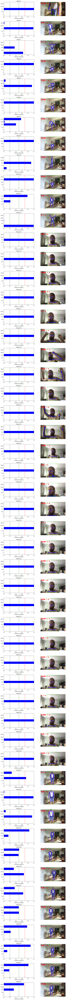

In [172]:
# Plotting
num_results = y_pred.shape[0]
num_columns = 2  # Number of columns (1 for the bar plot, 1 for the image)
subplot_width_ratio = 0.4  # Adjust this value to control the width of the bar plot side
subplot_height = 3  # Adjust this value to control the height of each subplot
num_rows = num_results
fig, axs = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * subplot_height),
                        gridspec_kw={'width_ratios': [subplot_width_ratio, 1-subplot_width_ratio]})

for i in range(num_results):
    ax_bar = axs[i, 0]
    ax_img = axs[i, 1]

    # Get class labels and predicted probabilities for the current result
    class_labels = list(label_mapping.keys())
    class_indices = list(label_mapping.values())
    predicted_probs = y_pred[i]

    # Plot bars for each class
    bars = ax_bar.barh(class_indices, predicted_probs, color='blue')

    # Set y-axis limits to always show 0 to 1 range
    ax_bar.set_xlim(0, 1)

    # Set y-axis labels and ticks
    ax_bar.set_yticks(class_indices)
    ax_bar.set_yticklabels(class_labels)

    # Set x-axis label
    ax_bar.set_xlabel('Predicted Probability')

    # Set bar plot title with actual label
    ax_bar.set_title(f"Result {i + 1}")

    # Display the image
    ax_img.imshow(X_images[i])
    ax_img.axis('off')  # Turn off axis numbers and ticks
    
    ax_bar.axvline(x=0.7, color='red', linestyle='dotted', linewidth=3)
    ax_bar.axvline(x=0.2, color='darkgreen', linestyle='dotted', linewidth=3)
    ax_bar.axvline(x=0.5, color='green', linestyle='dotted', linewidth=3)

plt.tight_layout()
#plt.savefig('prediction_probs.png')
plt.show()

In [38]:
predicted_class_index = np.argmax(y_pred)

In [43]:
y_pred[0]

array([0.00102071, 0.00130345, 0.99377763, 0.00228218, 0.00161612],
      dtype=float32)

In [44]:
class_labels = list(label_mapping.keys())

In [45]:
class_labels

['X', 'crane', 'empty', 'squat', 'stand']

In [46]:
class_indices = list(label_mapping.values())

In [47]:
class_indices

[0, 1, 2, 3, 4]

In [48]:
predicted_probs = y_pred[0]

In [49]:
predicted_probs

array([0.00102071, 0.00130345, 0.99377763, 0.00228218, 0.00161612],
      dtype=float32)

In [52]:
label_mapping['crane'] = 'unknown'

In [53]:
label_mapping

{'X': 0, 'crane': 'unknown', 'empty': 2, 'squat': 3, 'stand': 4}

In [57]:
X_landmarks

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.54089105, 0.26658437, 0.45187283, ..., 0.89823955, 0.4327088 ,
        0.90572476],
       [0.54198539, 0.2191352 , 0.44753021, ..., 0.88447315, 0.41679841,
        0.88845962],
       [0.52255523, 0.28928632, 0.43806472, ..., 0.8920179 , 0.39873376,
        0.89464241]])

In [63]:
landmark_coordinates = X_landmarks[20]

In [64]:
landmark_coordinates

array([0.56893075, 0.58185762, 0.45627707, 0.57425773, 0.58948648,
       0.71075809, 0.42708483, 0.71556753, 0.54664099, 0.82047749,
       0.47213298, 0.81397551, 0.53931224, 0.77536356, 0.47513193,
       0.77704483, 0.61526096, 0.78239053, 0.40497869, 0.78288233,
       0.53985119, 0.89845097, 0.46582547, 0.9047147 ])

#### For videostream prediction

In [66]:
landmark_folder = 'test_marco/landmarks'

In [68]:
os.listdir(landmark_folder)

['.DS_Store', 'empty', 'squat', 'crane', 'stand', 'X']

In [226]:
landmark_folder = 'test_marco/landmarks/empty'

In [227]:
landmark_file_path = os.path.join(landmark_folder, os.listdir(landmark_folder)[3])

In [228]:
landmark_coordinates = np.load(landmark_file_path)

In [229]:
landmark_coordinates

array([[0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.]])

In [174]:
def reshape_landmarks_single(X):
    X_reshaped = X.reshape(1, -1)
    return X_reshaped


In [180]:
landmark_coordinates

array([[0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.]])

In [191]:
landmark_coordinates.shape

(12, 2)

In [192]:
landmark_coordinates_flat = reshape_landmarks_single(landmark_coordinates)

In [193]:
landmark_coordinates_flat.shape

(1, 24)

In [194]:
landmark_coordinates_flat

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0.]])

In [198]:
prediction = model.predict(landmark_coordinates_flat)

1/1 [==============================] - 0s 19ms/step


In [199]:
prediction

array([[0.00102071, 0.00130345, 0.99377763, 0.00228218, 0.00161612]],
      dtype=float32)

In [200]:
(prediction*100).astype(int)

array([[ 0,  0, 99,  0,  0]])

In [143]:
label_mapping

{'X': 0, 'crane': 1, 'empty': 2, 'squat': 3, 'stand': 4}

In [113]:
predicted_class_index = np.argmax(prediction)

In [123]:
pred_prob = prediction[0][predicted_class_index]

In [124]:
pred_prob

0.9546332

In [139]:
if pred_prob < 0.7:
        predicted_label = "unknown"

In [140]:
if predicted_label == "crane":
    predicted_label = "unknown"

In [147]:
predicted_label = next(label for label, idx in label_mapping.items() if idx == predicted_class_index)

In [148]:
predicted_label

'X'

In [144]:
label_mapping

{'X': 0, 'crane': 1, 'empty': 2, 'squat': 3, 'stand': 4}

In [238]:
def predict_pose(landmark_coordinates, label_mapping):
    landmark_coordinates_flattened= landmark_coordinates.reshape(1, -1)
    prediction = model.predict(landmark_coordinates_flattened)
    predicted_pose_index = np.argmax(prediction)
    pred_prob = prediction[0][predicted_pose_index]

    predicted_label = next((label for label, idx in label_mapping.items() if idx == predicted_pose_index), "unknown")
    
    if pred_prob < 0.7:
        predicted_label = "unknown"
    
    if predicted_label == "crane":
        predicted_label = "unknown"
    
    return predicted_label

In [235]:
def predict_pose(landmark_coordinates, label_mapping):
    landmark_coordinates_flattened= landmark_coordinates.reshape(1, -1)
    prediction = model.predict(landmark_coordinates_flattened)
    predicted_pose_index = np.argmax(prediction)
    pred_prob = prediction[0][predicted_pose_index]
    predicted_label = next(label for label, idx in label_mapping.items() if idx == predicted_pose_index)
    
    if pred_prob < 0.7:
        predicted_label = "unknown"
    
    if predicted_label == "crane":
        predicted_label = "unknown"
    
    return predicted_label
        

In [239]:
predicted_label = predict_pose(landmark_coordinates, label_mapping)

1/1 [==============================] - 0s 20ms/step


In [240]:
predicted_label

'empty'

In [ ]:
# test function 

In [157]:
landmark_folder = "test_marco/landmarks"

In [158]:
os.listdir(landmark_folder)

['.DS_Store', 'empty', 'squat', 'crane', 'stand', 'X']

In [218]:
predicted_labels_list = []

for subfolder in os.listdir(landmark_folder):
    subfolder_path = os.path.join(landmark_folder, subfolder)
    
    if os.path.isdir(subfolder_path):  
        for file in os.listdir(subfolder_path):
            if not file.startswith('.'):
                file_path = os.path.join(subfolder_path, file)
                landmark_coordinates = np.load(file_path)
                
                predicted_label = predict_pose(landmark_coordinates, label_mapping)
                
                predicted_labels_list.append(predicted_label)

1/1 [==============================] - 0s 17ms/step


In [219]:
predicted_labels_list

['empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'empty',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'squat',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'unknown',
 'stand',
 'stand',
 'stand',
 'stand',
 'stand',
 'stand',
 'stand',
 'stand',
 'stand',
 'stand',
 'stand',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X',
 'X']

In [150]:
landmark_coordinates

array([[0.55294597, 0.25067306],
       [0.46259189, 0.24718437],
       [0.62501729, 0.18545149],
       [0.39670414, 0.18251714],
       [0.669029  , 0.08136377],
       [0.34820038, 0.07992978],
       [0.53315091, 0.53512812],
       [0.47826725, 0.54004896],
       [0.55766124, 0.73515385],
       [0.45876703, 0.73731154],
       [0.58622032, 0.91244245],
       [0.4323341 , 0.90947068]])

In [126]:
label_mapping

{'X': 0, 'crane': 1, 'empty': 2, 'squat': 3, 'stand': 4}

In [ ]:
landmark_data = np.load(landmark_path)

In [ ]:
def predict_pose(landmark_coordinates, label_mapping):
    

In [ ]:
def predict_pose(lan

In [41]:
 # Get class labels and predicted probabilities for the current result
    
    
    class_labels = list(label_mapping.keys())
    class_indices = list(label_mapping.values())
    predicted_probs = y_pred[i]
    actual_label = class_labels[y_actuals[i]]  # Get the actual label based on y_actuals


array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 1, 0, 0, 1, 1, 4, 1, 0, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [36]:
y_pred_classes

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 1, 0, 0, 1, 1, 4, 1, 0, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [37]:
y_pred

array([[1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.3034

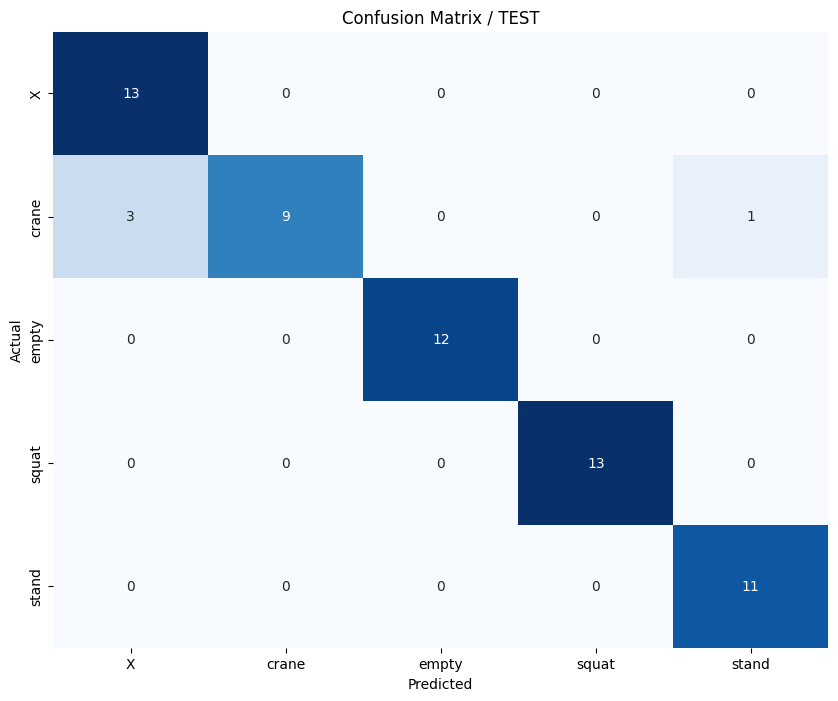

In [23]:
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, y_pred_classes)

# Get class labels from the label_mapping dictionary
class_labels = [label for label, idx in sorted(label_mapping.items(), key=lambda x: x[1])]

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix / TEST')
plt.savefig('cm_1.png')
plt.show()

### Show probabilities

In [309]:
test_landmarks = 'test_marco/landmarks'

In [310]:
X_test, _ = load_and_preprocess_test_data(test_landmarks, label_mapping)

In [312]:
y_pred = model.predict(X_test)

2/2 [==============================] - 0s 5ms/step


In [314]:
test_pictures = 'test_marco/pictures'

In [342]:
def load_pics(folder_pics):
    pic_list = []

    for label in os.listdir(test_folder):
        label_folder = os.path.join(test_folder, label)
        
        if os.path.isdir(label_folder):
            for file_name in os.listdir(label_folder):
                if file_name.endswith('.jpg'):
                    image = Image.open(os.path.join(label_folder, file_name))
                    pic_list.append(image)

    return pic_list

In [343]:
pic_list = load_pics(test_pictures)

In [347]:
type(y_pred)

numpy.ndarray

In [181]:
import os
import numpy as np
from PIL import Image

def load_and_process_images_and_landmarks(image_folder, landmark_folder, label_map):
    X_images = []
    X_landmarks = []
    y = []

    label_mapping = label_map

    for label in os.listdir(image_folder):
        image_label_folder = os.path.join(image_folder, label)
        landmark_label_folder = os.path.join(landmark_folder, label)

        if os.path.isdir(image_label_folder) and os.path.isdir(landmark_label_folder):
            for image_name in os.listdir(image_label_folder):
                if image_name.endswith('.jpg'):
                    image = Image.open(os.path.join(image_label_folder, image_name))
                    X_images.append(image)

                    landmark_name = image_name.replace('.jpg', '.npy')
                    landmark_path = os.path.join(landmark_label_folder, landmark_name)
                    landmark_data = np.load(landmark_path)
                    X_landmarks.append(landmark_data)

                    y.append(label_mapping[label])

    X_landmarks = np.array(X_landmarks)
    X_landmarks_flattened = reshape_landmarks(X_landmarks)
    
    y = np.array(y)

    return X_images, X_landmarks_flattened, y


label_mapping = label_mapping

# Load images, landmarks, and perform prediction
image_folder = 'test_marco/pictures'
landmark_folder = 'test_marco/landmarks'
X_images, X_landmarks, y_actuals = load_and_process_images_and_landmarks(image_folder, landmark_folder, label_mapping)


In [182]:
X_landmarks

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.54089105, 0.26658437, 0.45187283, ..., 0.89823955, 0.4327088 ,
        0.90572476],
       [0.54198539, 0.2191352 , 0.44753021, ..., 0.88447315, 0.41679841,
        0.88845962],
       [0.52255523, 0.28928632, 0.43806472, ..., 0.8920179 , 0.39873376,
        0.89464241]])

In [183]:
predictions = model.predict(X_landmarks)
predicted_class_index = np.argmax(predictions)

2/2 [==============================] - 0s 2ms/step


In [184]:
X_landmarks.shape

(62, 24)

In [185]:
num_images = len(X_images)

In [186]:
y_pred.shape

(62, 5)

In [190]:
predictions

array([[1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.30344753e-03, 9.93777633e-01, 2.28218362e-03,
        1.61612208e-03],
       [1.02070579e-03, 1.3034

In [187]:
len(X_images)

62

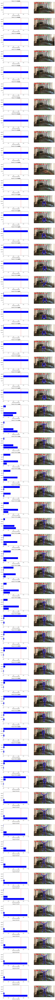

In [241]:
# Plotting
num_results = y_pred.shape[0]
num_columns = 2  # Number of columns (1 for the bar plot, 1 for the image)
subplot_width_ratio = 0.4  # Adjust this value to control the width of the bar plot side
subplot_height = 3  # Adjust this value to control the height of each subplot
num_rows = num_results
fig, axs = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * subplot_height),
                        gridspec_kw={'width_ratios': [subplot_width_ratio, 1-subplot_width_ratio]})

for i in range(num_results):
    ax_bar = axs[i, 0]
    ax_img = axs[i, 1]

    # Get class labels and predicted probabilities for the current result
    class_labels = list(label_mapping.keys())
    class_indices = list(label_mapping.values())
    predicted_probs = y_pred[i]
    actual_label = class_labels[y_actuals[i]]  # Get the actual label based on y_actuals

    # Plot bars for each class
    bars = ax_bar.barh(class_indices, predicted_probs, color='blue')

    # Set y-axis limits to always show 0 to 1 range
    ax_bar.set_xlim(0, 1)

    # Set y-axis labels and ticks
    ax_bar.set_yticks(class_indices)
    ax_bar.set_yticklabels(class_labels)

    # Set x-axis label
    ax_bar.set_xlabel('Predicted Probability')

    # Set bar plot title with actual label
    ax_bar.set_title(f"Result {i + 1} for $\mathbf{{{actual_label}}}$")

    # Display the image
    ax_img.imshow(X_images[i])
    ax_img.axis('off')  # Turn off axis numbers and ticks
    
    ax_bar.axvline(x=0.7, color='red', linestyle='dotted', linewidth=3)

plt.tight_layout()
plt.savefig('prediction_probs.png')
plt.show()